# Convert audio files into spectrogram videos

Based on:   
https://github.com/fabincarmo/vidwav  
by fabincarmo@gmail.com  

TODO: on the upper plot draw a spectrum of current frame 

In [4]:
from pathlib import Path

import matplotlib
import numpy as np

matplotlib.use("Agg")
import os

import librosa
import librosa.display
import matplotlib.pyplot as plt
import pandas as pd

pow2 = pd.DataFrame([2**i for i in range(15)], list(range(15))).transpose()
pow2

import glob
import wave

import matplotlib.animation as manimation
from matplotlib.ticker import FuncFormatter
from PIL import Image

%matplotlib inline

## Preprocessing: convert audio formats
In case your files are not in wav format, use this short command.  
However you probably dont need this, as librosa supports a wide variety of formats

```
ffmpeg -loglevel error -i Media/lpf.mp3 Media/lpf.wav
```

## Functions

In [5]:
def wav2mp4(
    wavfile,
    spec_params={},
    scale="linear",
    figsize=(9.60, 7.20),
    fps=25,
    cmap="magma",
    save=True,
):
    """
    spec_params: spectral parameters;
                 dict with these keys: {'n_fft': 1024,
                                        'hop_length': 128,
                                        'n_mels': 256}
    scale: mel, linear, log
    figsize: figure size, inches, default:  (9.60,7.20)
    cmap: colormap to use for spectrogram, default 'magma'
    fps: desired video fps, default 25
    save: whether to actually save a video file.
    since it takes some time to save, you might
    want to preview the image first.
    A .png image is saved anyway.
    """

    audio, fs = librosa.load(wavfile)
    # trim silent edges
    audio, _ = librosa.effects.trim(audio)

    # 1920, 1080
    # (19.20, 10.80)
    # (9.60,7.20)
    # (6.4, 4.8)
    fig = plt.figure(figsize=(9.60, 7.20))  # )

    sig = fig.add_subplot(16, 1, (1, 2))
    sig.margins(x=0)

    librosa.display.waveshow(audio, sr=fs, axis="time", ax=sig)
    sig.set_xlabel("")

    (l1,) = sig.plot([], [], "#333333", lw=2)

    spec = fig.add_subplot(16, 1, (3, 16))

    if spec_params == {}:  # default
        spec_params = {"n_fft": 1024, "hop_length": 128, "n_mels": 256}

    print("drawing spectrogram with params:", spec_params)

    if scale == "mel":
        S = librosa.feature.melspectrogram(y=audio, **spec_params)
        DB = librosa.power_to_db(S, ref=np.max)

    else:
        spec_params.pop("n_mels", None)  # not relevant for regular spectrograms
        D = np.abs(librosa.stft(y=audio, **spec_params))
        DB = librosa.amplitude_to_db(D, ref=np.max)

    librosa.display.specshow(
        DB,
        sr=fs,
        hop_length=spec_params["hop_length"],
        x_axis="time",
        y_axis=scale,
        ax=spec,
        cmap=cmap,
    )

    # plt.colorbar((format='%+2.0f dB');

    spec.set_xlabel("Time (sec)")
    spec.set_ylabel(f'Frequency (Hz) | Scale: {scale} | NFFT: {spec_params["n_fft"]}')
    formatter = FuncFormatter(kilo)
    spec.yaxis.set_major_formatter(formatter)
    (l2,) = spec.plot([], [], "#ffffff", lw=2)

    plt.tight_layout()
    plt.show()

    x = np.array([0.0, 0.0])
    y0 = np.array([-1, 1])
    y1 = np.array([0, fs / 2 * 1000.0])

    pth = Path(wavfile)
    pts = list(
        pth.parts[:-1]
        + (pth.stem + "." + scale + "." + "{:05d}".format(spec_params["n_fft"]),)
    )
    out_fname = Path(*pts)

    # out_fname = wavfile.split('.')[0] + '.' + scale + '.' + "{:05d}".format(spec_params["n_fft"])
    fig.savefig(str(out_fname) + ".png")

    if save:
        print("saving video: " + str(out_fname) + ".mp4")
        duration = librosa.get_duration(y=audio, sr=fs)
        FFMpegWriter = manimation.writers["ffmpeg"]
        metadata = dict(title="Wav Spectrogram", artist="Matplotlib", comment="")
        writer = FFMpegWriter(fps=fps, metadata=metadata, bitrate=3500)

        with writer.saving(fig, "temp.mp4", 100):
            n_frames = (int(duration) + 1) * fps
            for i in range(n_frames):
                print(f"\rwrite frame {i+1}/{n_frames}", end="")
                x += 1.0 / float(fps)
                l1.set_data(x, y0)
                l2.set_data(x, y1)
                writer.grab_frame()

        print("\nadding sound to video")
        os.system(
            'ffmpeg -loglevel error -y -i "'
            + wavfile
            + '" -i temp.mp4 -c:v copy -strict -2 "'
            + str(out_fname)
            + '.mp4"'
        )
        os.remove("temp.mp4")
        print("saved to " + str(out_fname) + ".mp4")
    return fig

In [6]:
def kilo(x, pos):
    return "%1.1fk" % (x * 1e-3)

In [7]:
def make_gif(files_pattern="*.png"):
    # f"{frame_folder}/*"
    glb = glob.glob(files_pattern)
    print(files_pattern)
    glb.sort()
    print(glb)
    frames = [Image.open(image) for image in glb]
    print(len(frames))
    frame_one = frames[0]
    outfile = files_pattern.replace("*", "").replace(".png", ".gif")
    frame_one.save(
        outfile, format="GIF", append_images=frames, save_all=True, duration=700, loop=0
    )

In [8]:
save = 0

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 128}


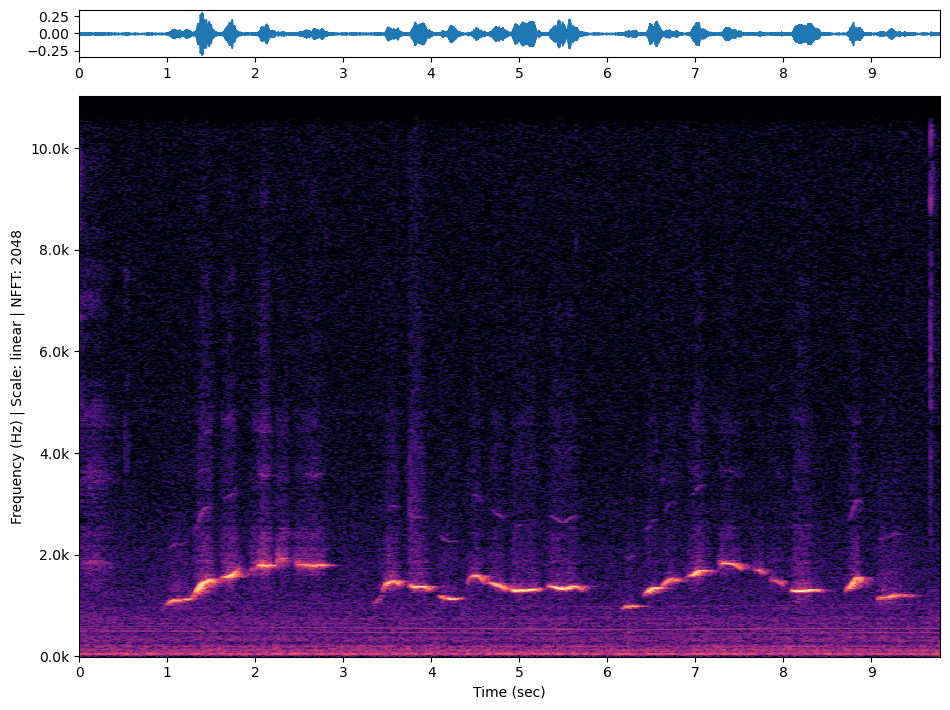

In [10]:
sp = {"n_fft": 2**11, "hop_length": 128, "n_mels": 128}
fig = wav2mp4("wantugone.wav", scale="linear", save=save, spec_params=sp)

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 128}


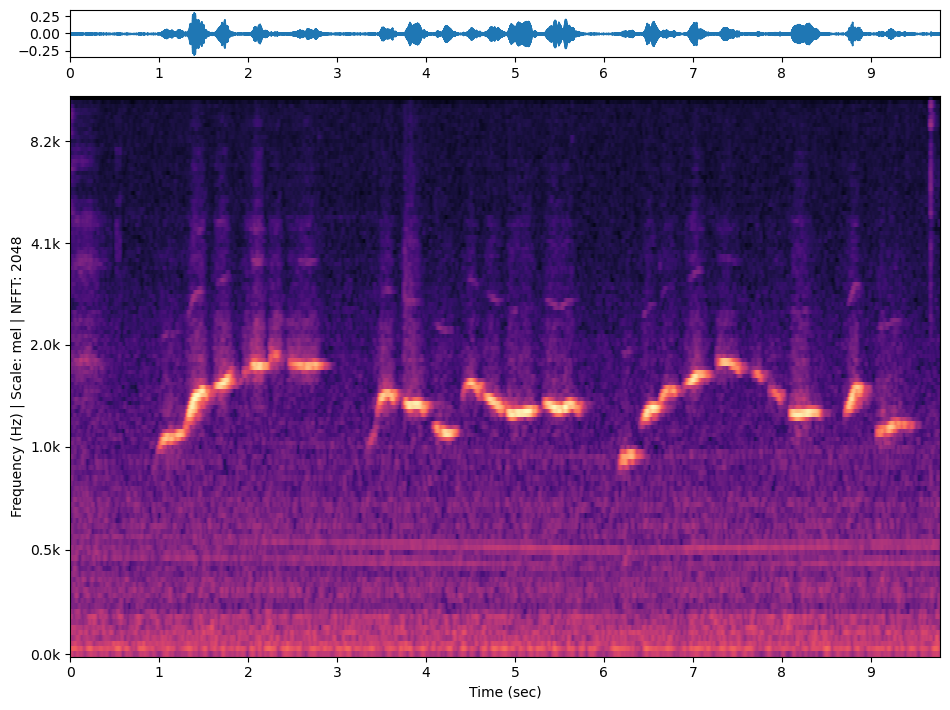

In [12]:
sp = {"n_fft": 2**11, "hop_length": 128, "n_mels": 128}
fig = wav2mp4("wantugone.wav", scale="mel", save=save, spec_params=sp)

drawing spectrogram with params: {'n_fft': 1024, 'hop_length': 128, 'n_mels': 256}


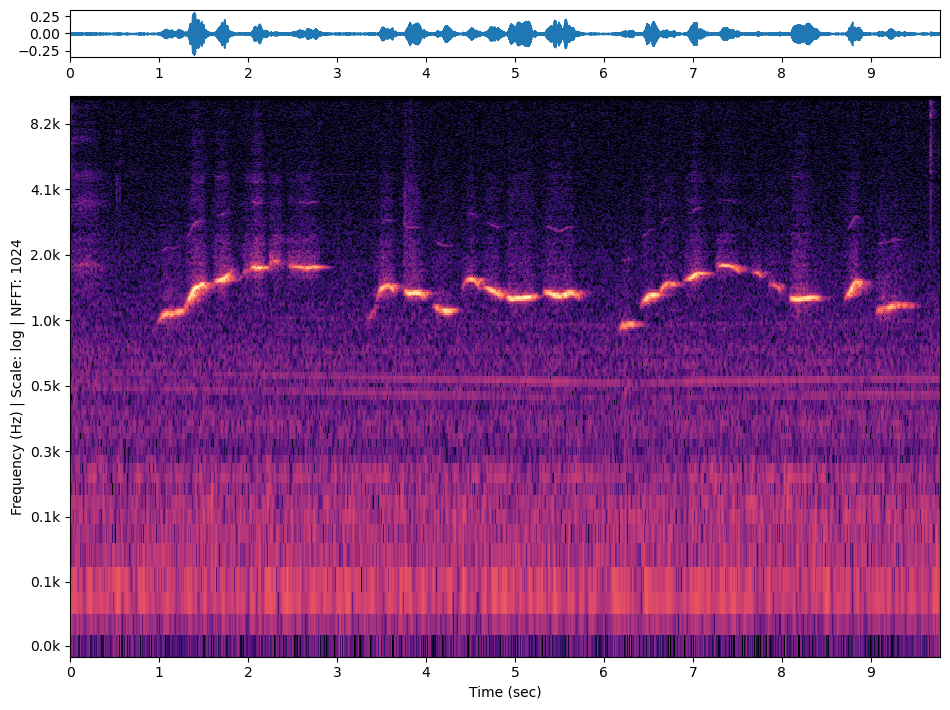

In [13]:
fig = wav2mp4("wantugone.wav", scale="log", save=save)

## Videos for presentation 

spiritus.wav  
fiona.wav  
sacrifice.wav  
trumpet.wav  
dolphin.wav  
environment.wav  

music_gt_2.wav  
music_audiosr_2.wav  
music_up_2.wav  
speech_gt_1.wav  
speech_up_1.wav  
speech_audiosr_1.wav  
event_gt_3.wav  
event_up_3.wav  

lpf.wav  

In [14]:
save = 0

drawing spectrogram with params: {'n_fft': 1024, 'hop_length': 128, 'n_mels': 128}


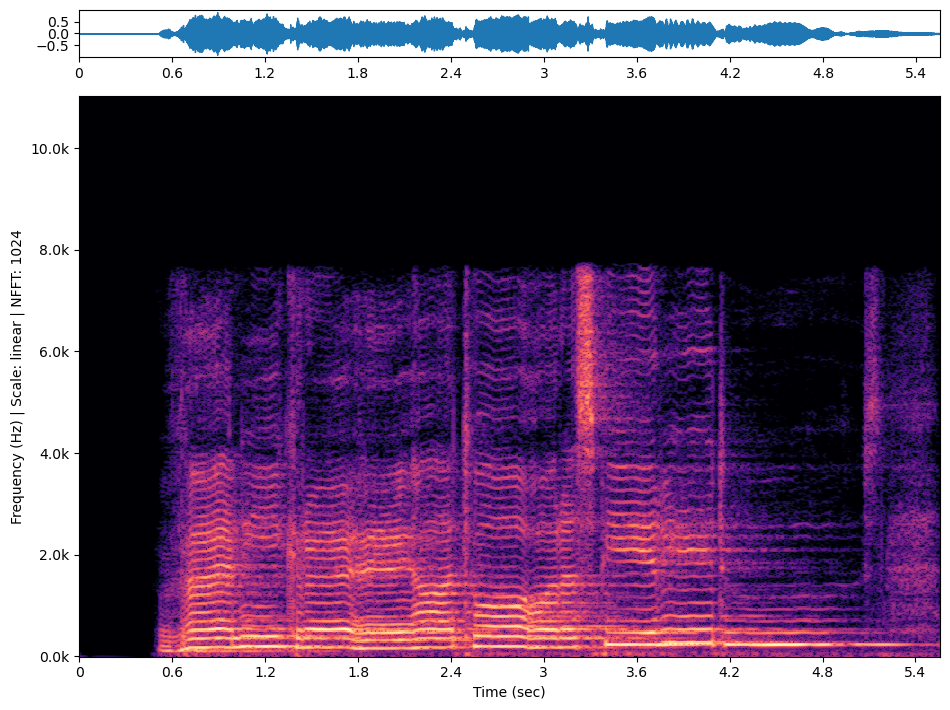

In [15]:
scale = "linear"
sp = {"n_fft": 1024, "hop_length": 128, "n_mels": 128}
fig = wav2mp4("Media/spiritus.wav", scale=scale, save=save, spec_params=sp)

### fiona

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 256}


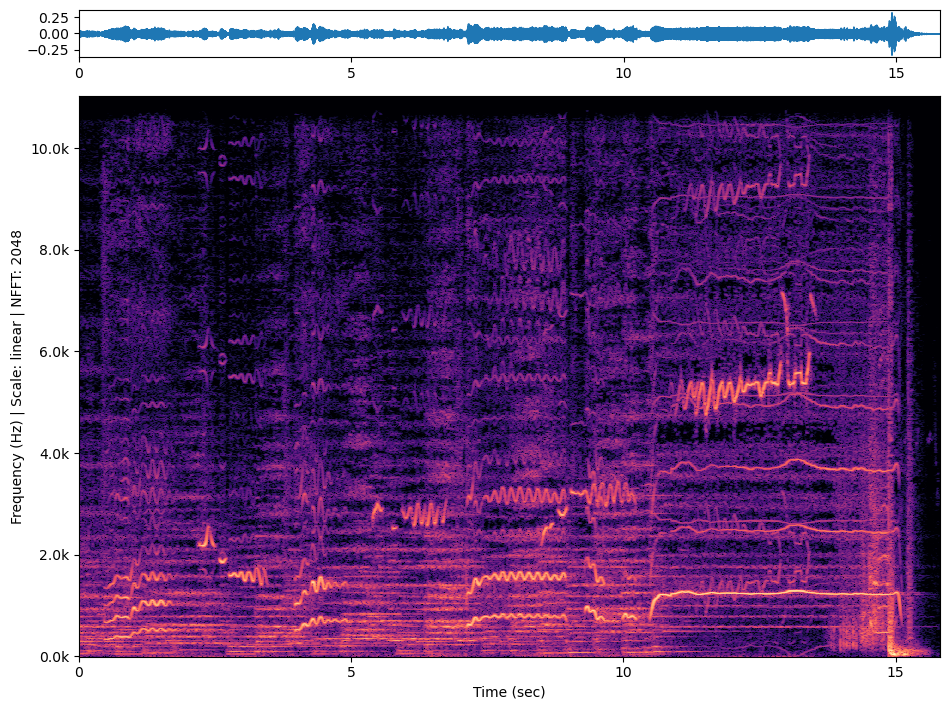

In [16]:
sp = {"n_fft": 2048, "hop_length": 128, "n_mels": 256}
fig = wav2mp4("Media/fiona.wav", scale=scale, save=save, spec_params=sp)

### sacrifice

drawing spectrogram with params: {'n_fft': 1024, 'hop_length': 128, 'n_mels': 256}


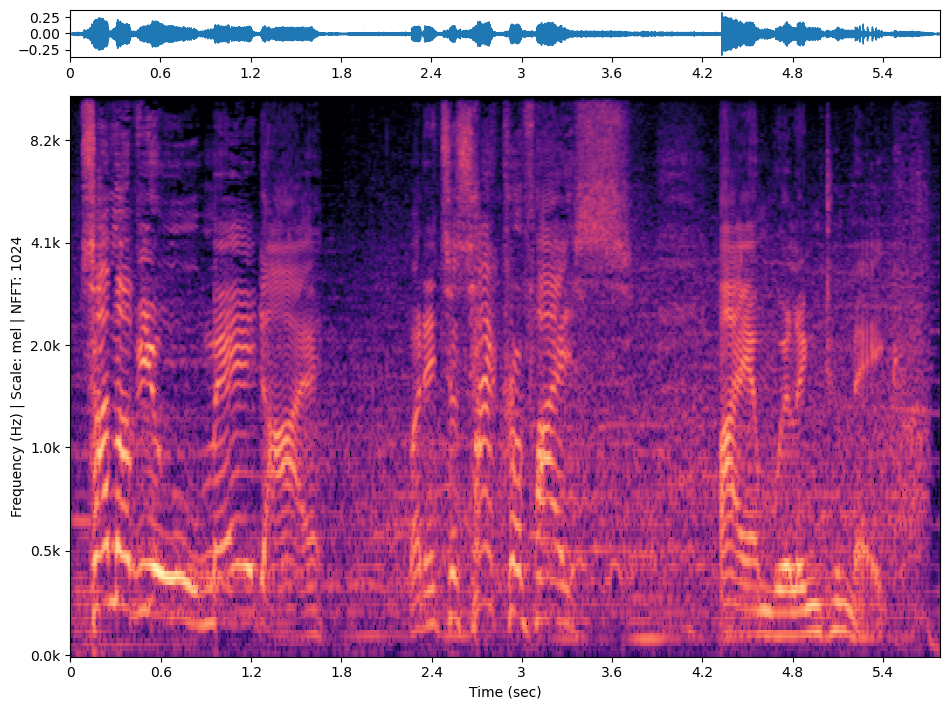

In [17]:
scale = "mel"
sp = {"n_fft": 1024, "hop_length": 128, "n_mels": 256}
fig = wav2mp4("Media/sacrifice.wav", scale=scale, save=save, spec_params=sp)

### trumpet

drawing spectrogram with params: {'n_fft': 1024, 'hop_length': 128, 'n_mels': 256}


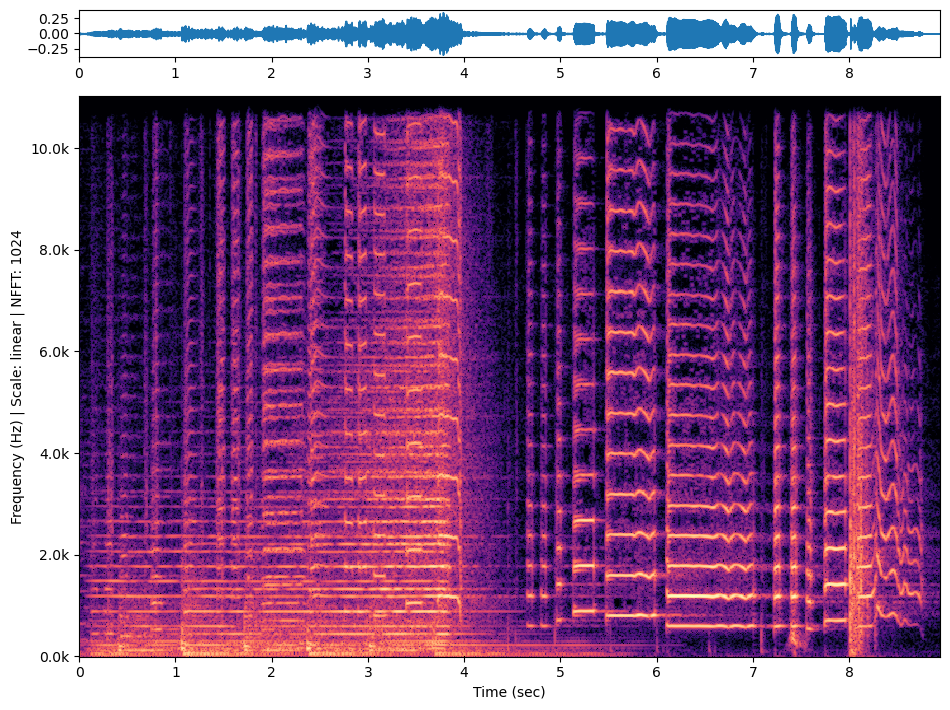

In [18]:
scale = "linear"
sp = {"n_fft": 1024, "hop_length": 128, "n_mels": 256}
fig = wav2mp4("Media/trumpet.wav", scale=scale, save=save, spec_params=sp)

### dolphin

drawing spectrogram with params: {'n_fft': 256, 'hop_length': 128, 'n_mels': 32}


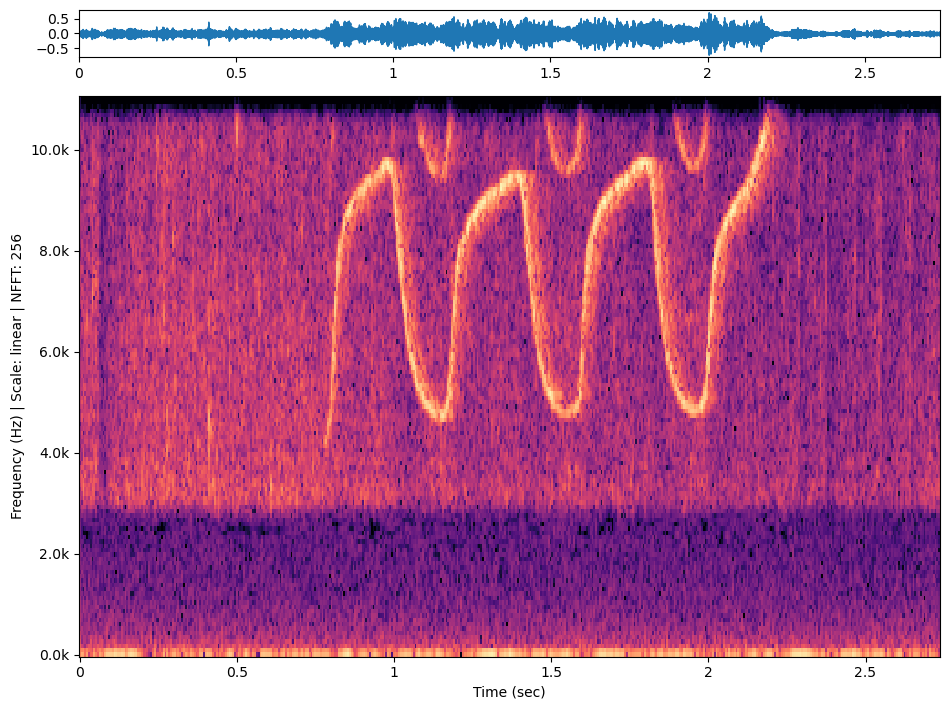

In [39]:
scale = "linear"
f = 8
sp = {"n_fft": 2**f, "hop_length": 2 ** (f - 1), "n_mels": 2 ** (f - 3)}
fig = wav2mp4("Media/dolphin.wav", scale=scale, save=save, spec_params=sp)

### environment

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 64, 'n_mels': 512}


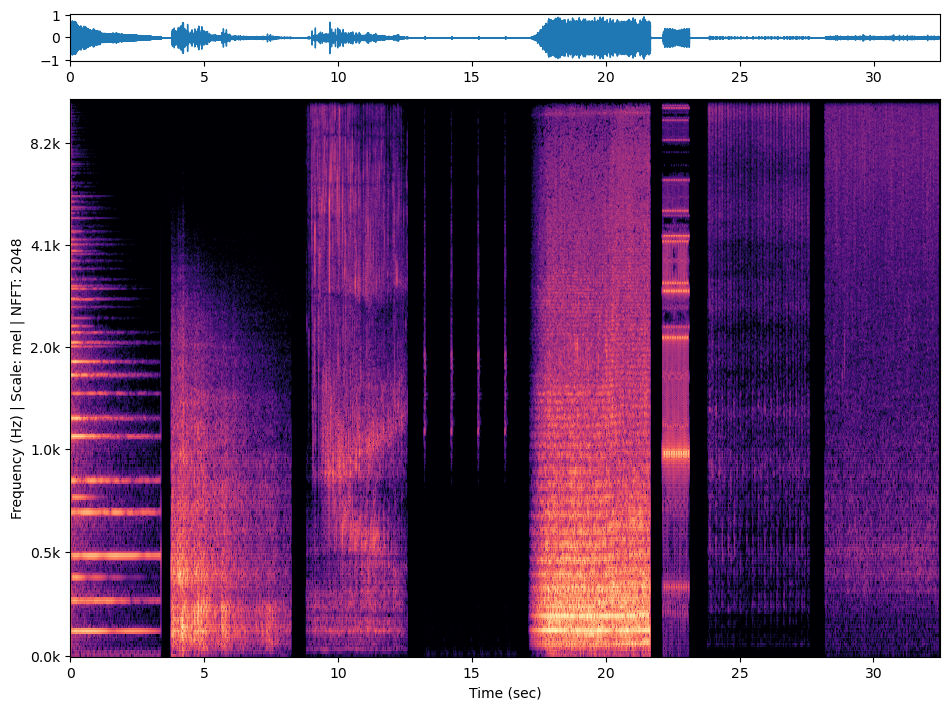

In [48]:
scale = "mel"
p = 11
sp = {"n_fft": 2**p, "hop_length": 2 ** (p - 5), "n_mels": 2 ** (p - 2)}
fig = wav2mp4("Media/environment.wav", scale=scale, save=save, spec_params=sp)

### audiosr samples

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


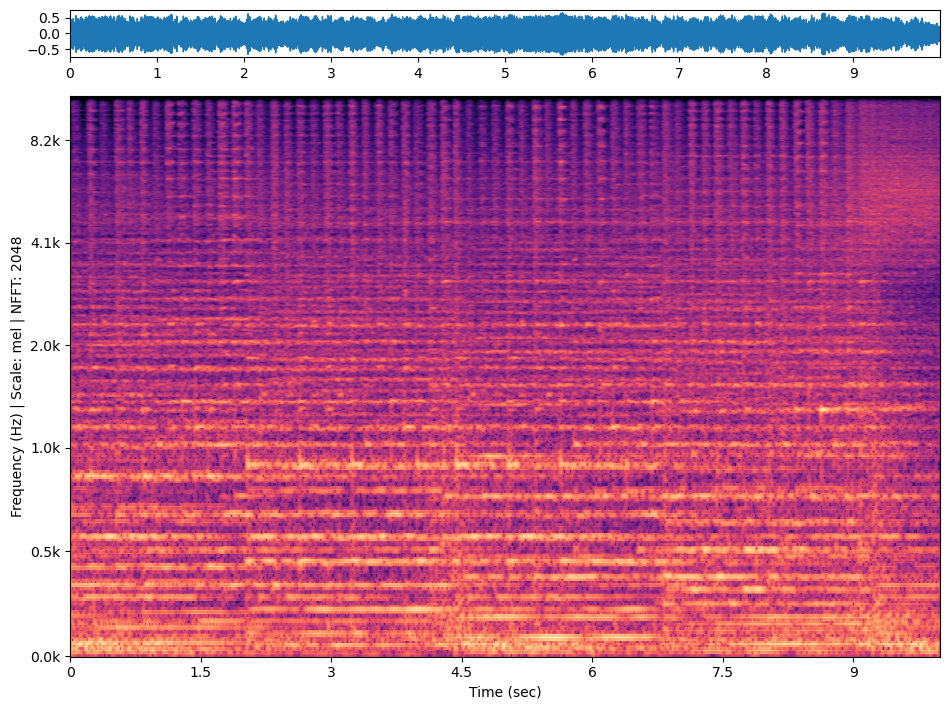

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


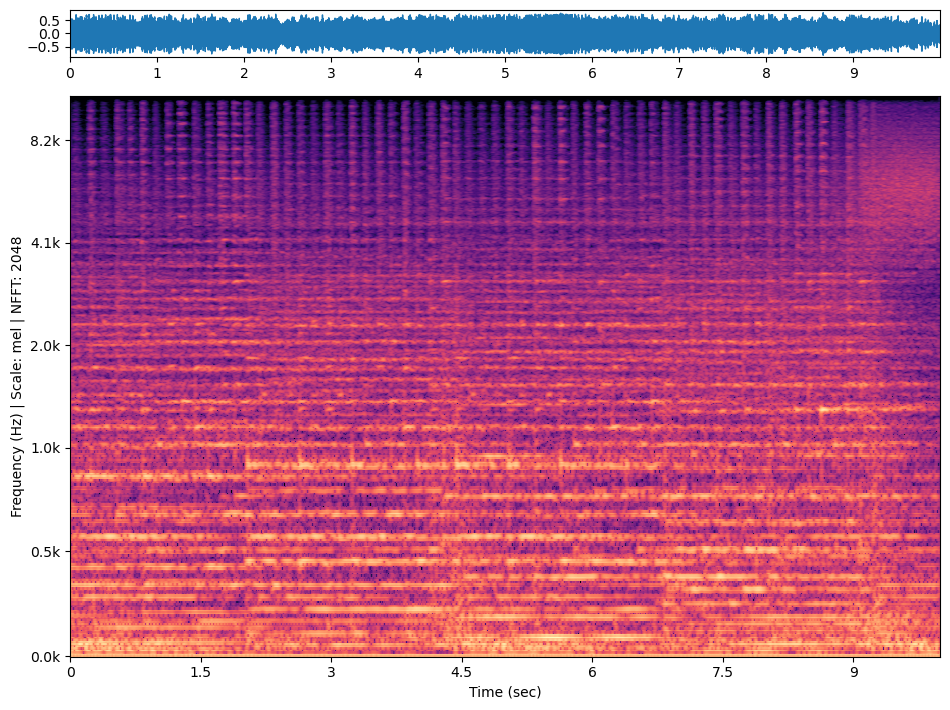

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


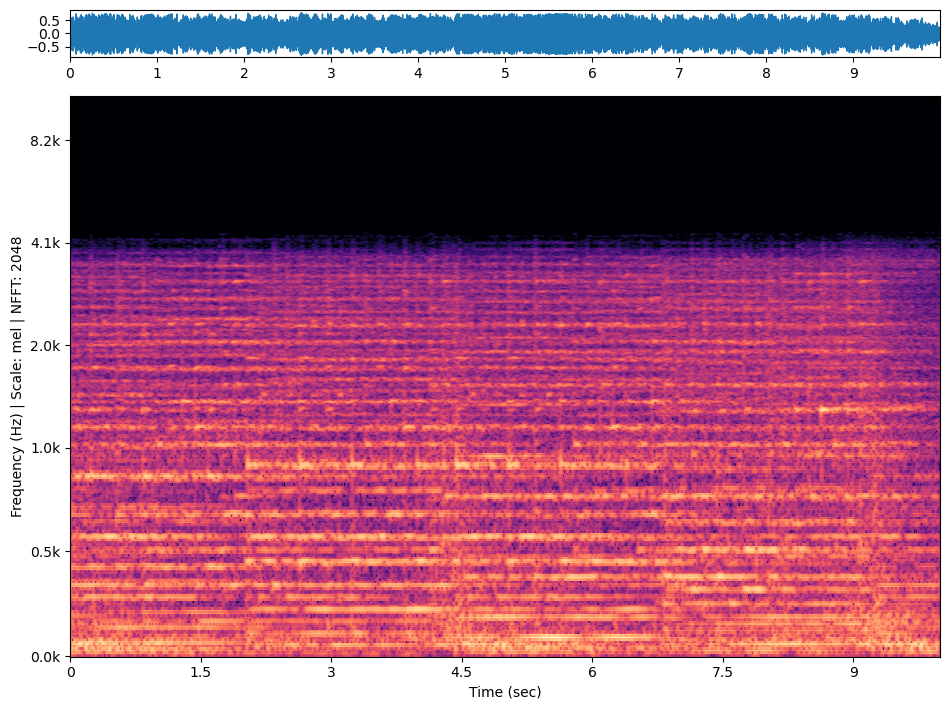

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


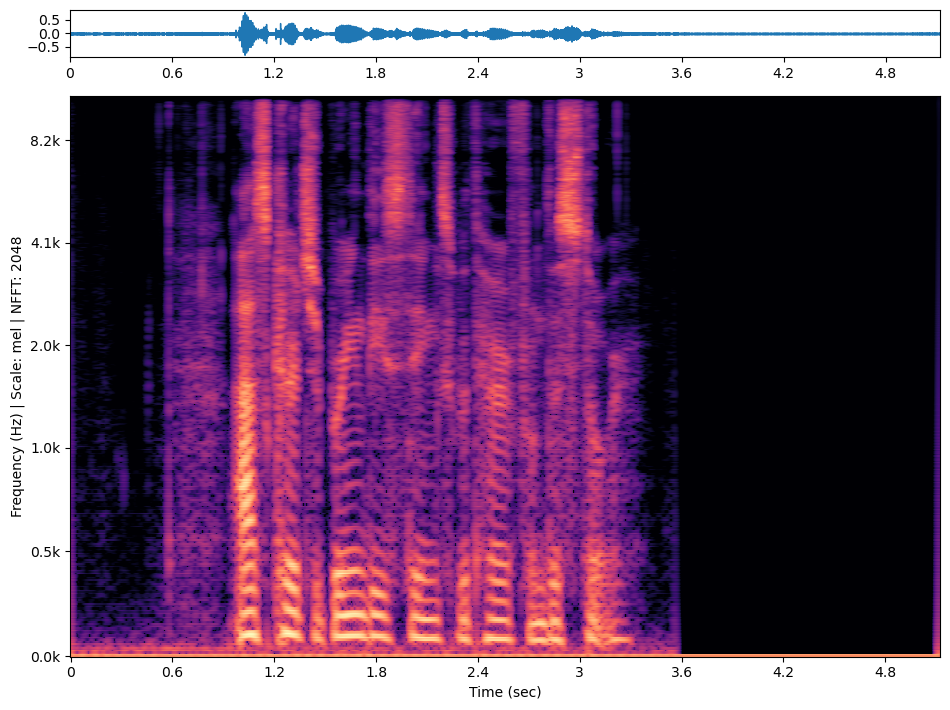

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


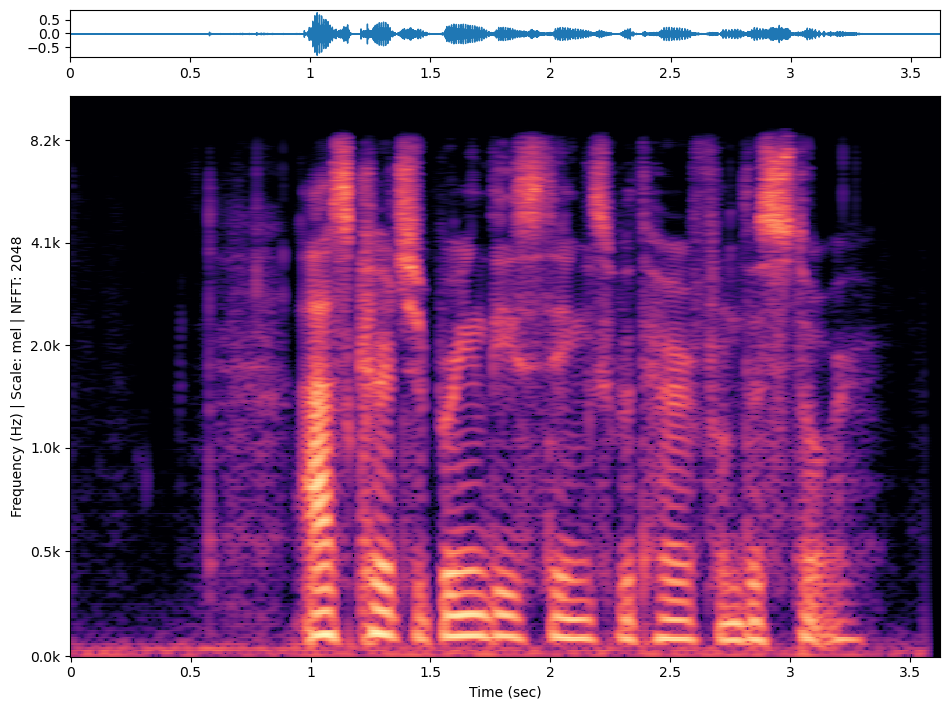

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


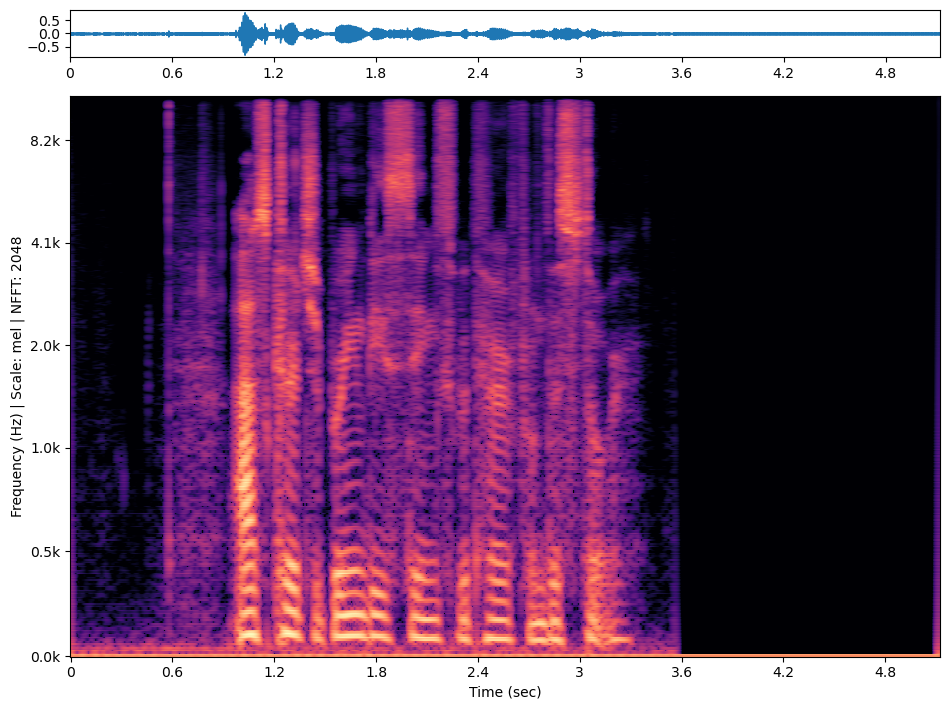

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


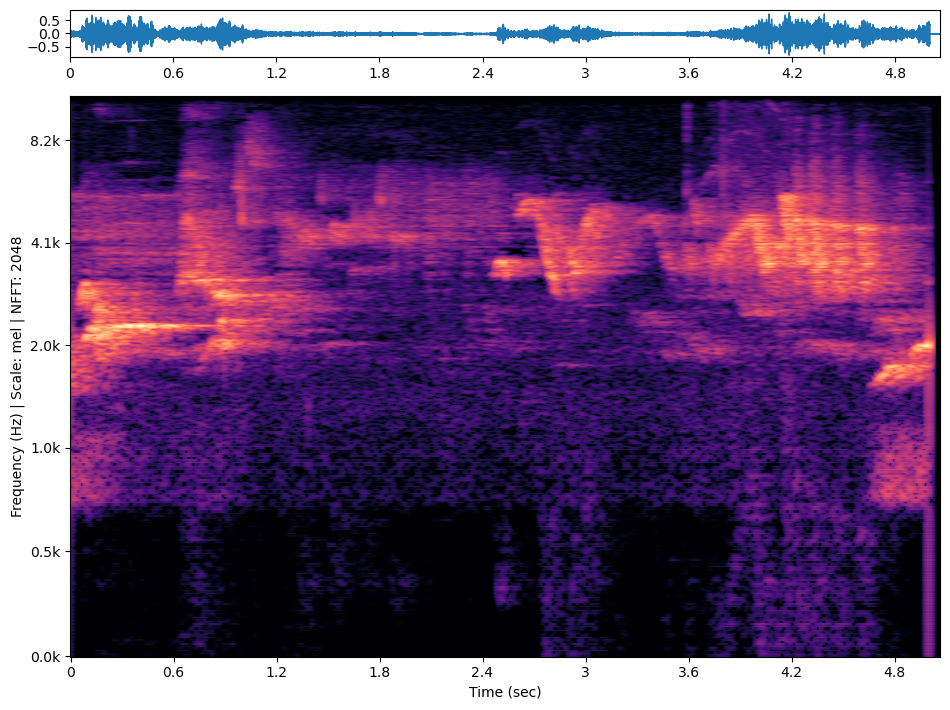

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


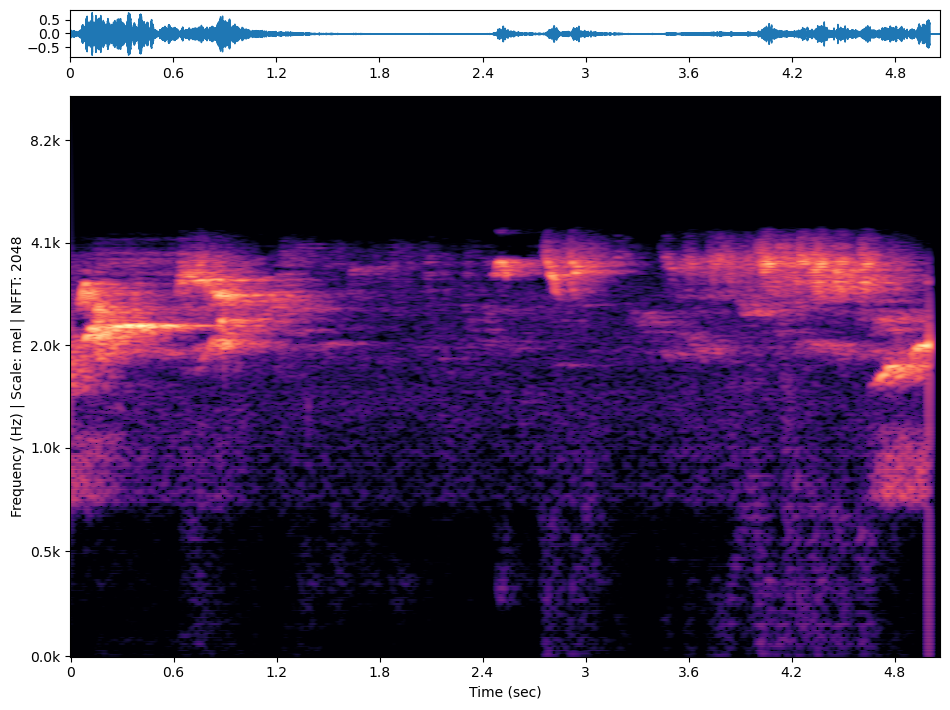

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


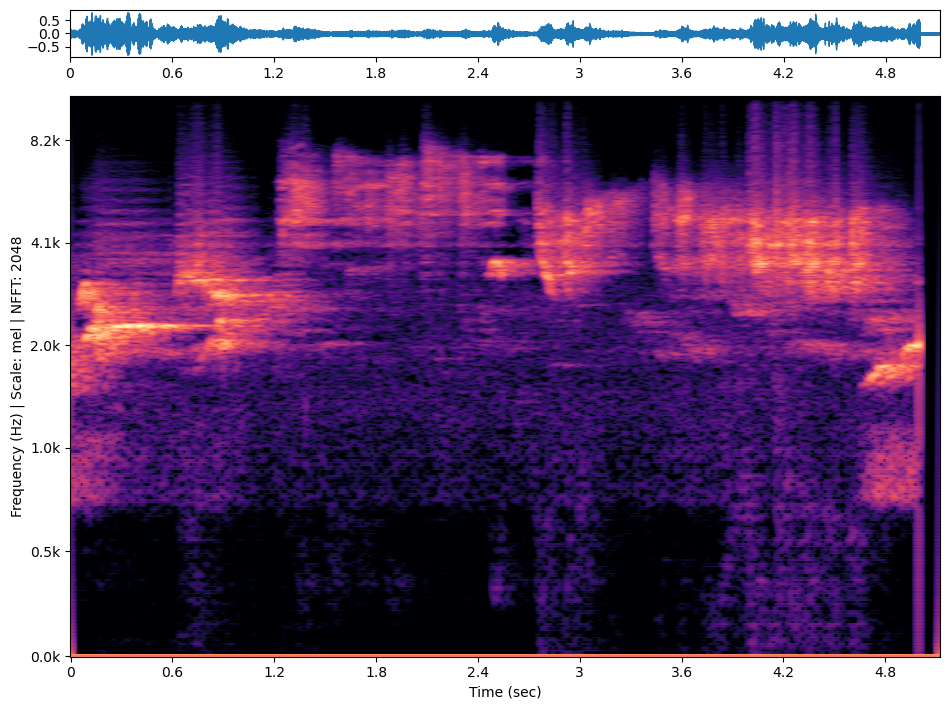

In [49]:
audiosr = """music_gt_2.wav
music_audiosr_2.wav
music_up_2.wav
speech_gt_1.wav
speech_up_1.wav
speech_audiosr_1.wav
event_gt_3.wav
event_up_3.wav
event_audiosr_3.wav"""

scale = "mel"  # "linear" #

i = 11
for f in audiosr.split("\n"):

    sp = {"n_fft": 2**i, "hop_length": 128, "n_mels": 2 ** (i - 2)}
    fig = wav2mp4("Media/" + f, scale=scale, save=save, spec_params=sp)

### low pass filtered

{'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}
drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


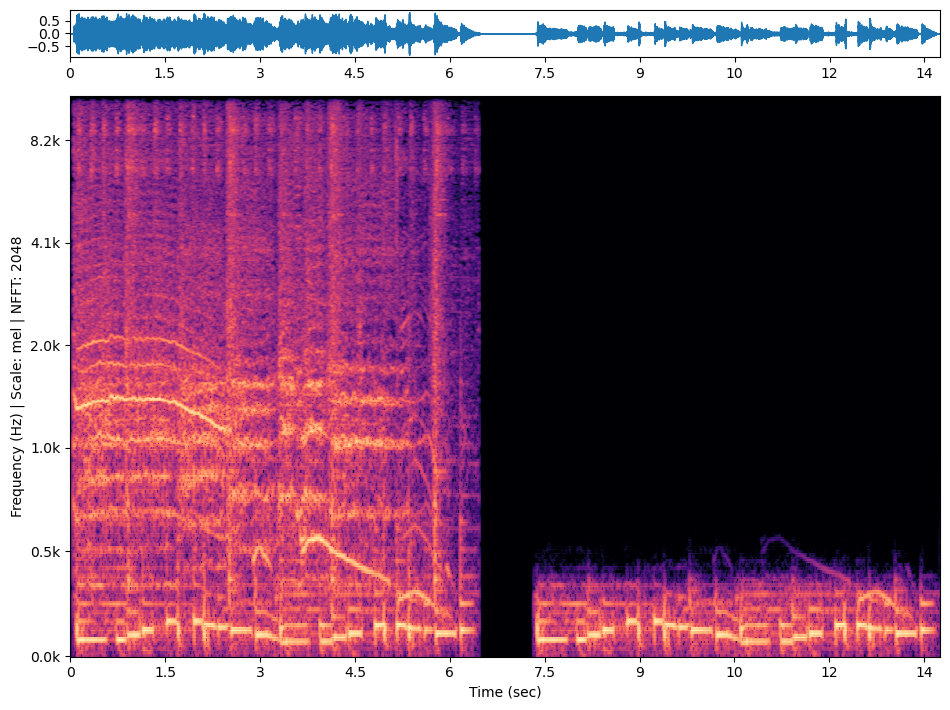

In [50]:
scale = "mel"
i = 11
save = 0
sp = {"n_fft": 2048, "hop_length": 128, "n_mels": 2 ** (i - 2)}
print(sp)
fig = wav2mp4("Media/lpf.wav", scale=scale, save=save, spec_params=sp)

## GIFs for presentation


### layers - variable NFFT
```
layers.*.mel.gif
```
Demonstrates how time/frequency smoothness of a resulting image varies with nfft 

drawing spectrogram with params: {'n_fft': 256, 'hop_length': 128, 'n_mels': 64}


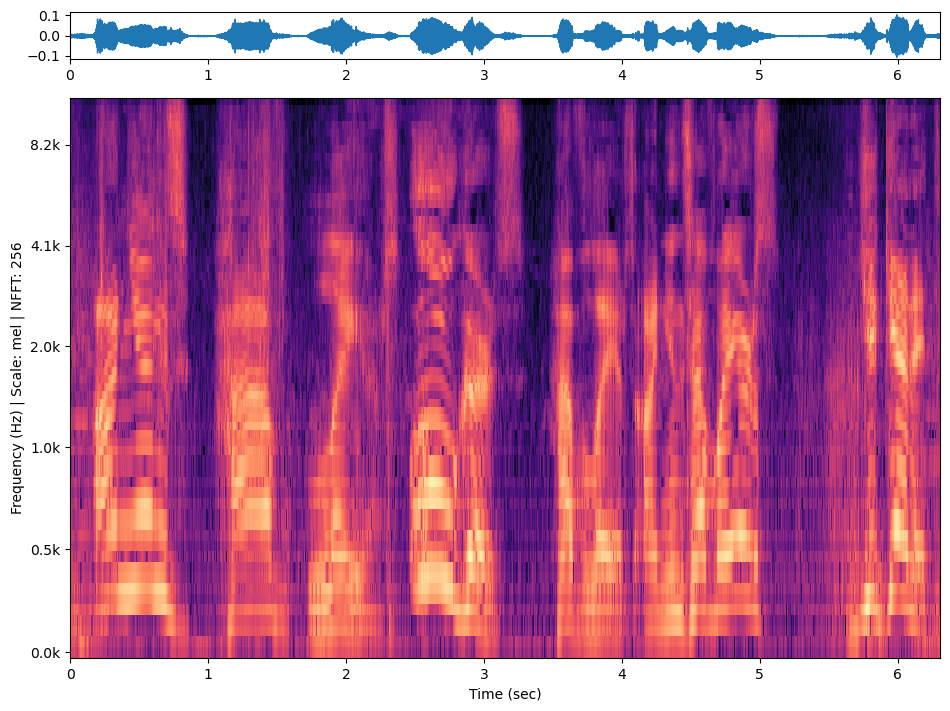

drawing spectrogram with params: {'n_fft': 512, 'hop_length': 128, 'n_mels': 128}


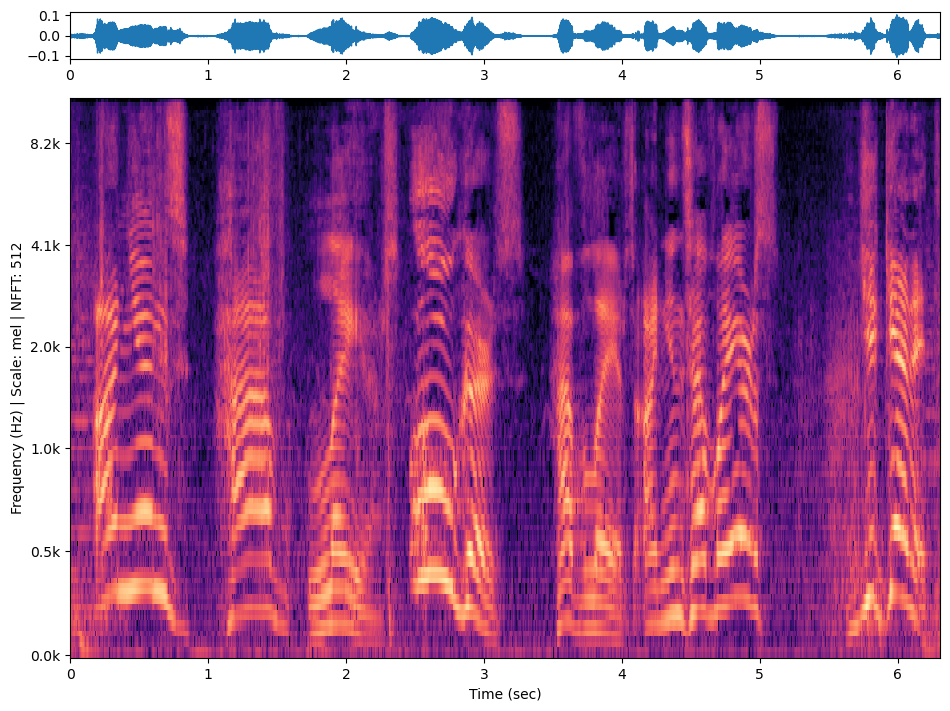

drawing spectrogram with params: {'n_fft': 1024, 'hop_length': 128, 'n_mels': 256}


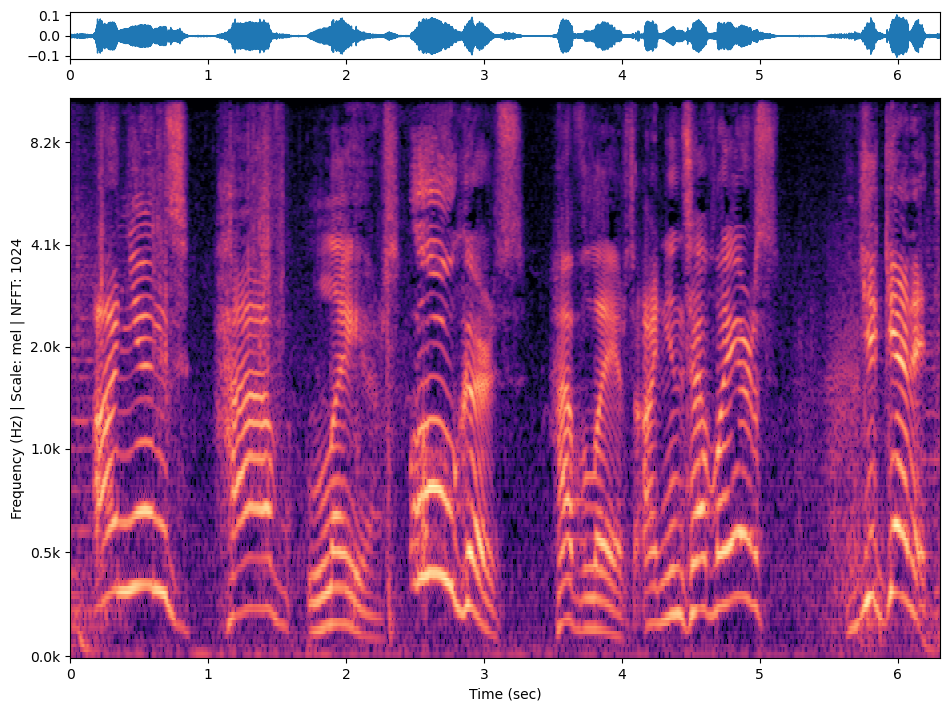

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


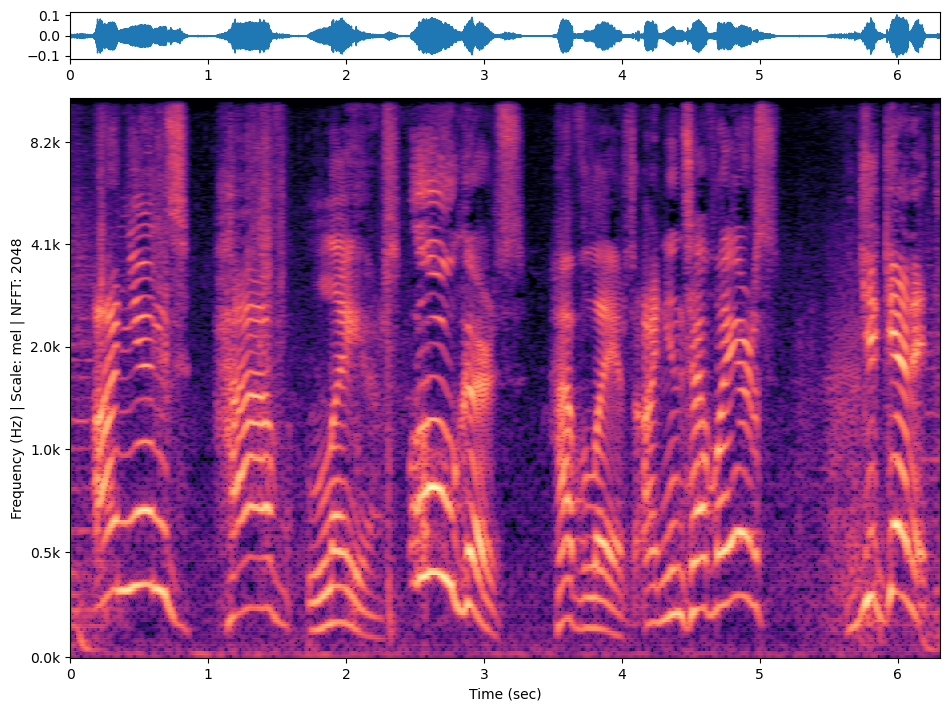

drawing spectrogram with params: {'n_fft': 4096, 'hop_length': 128, 'n_mels': 1024}


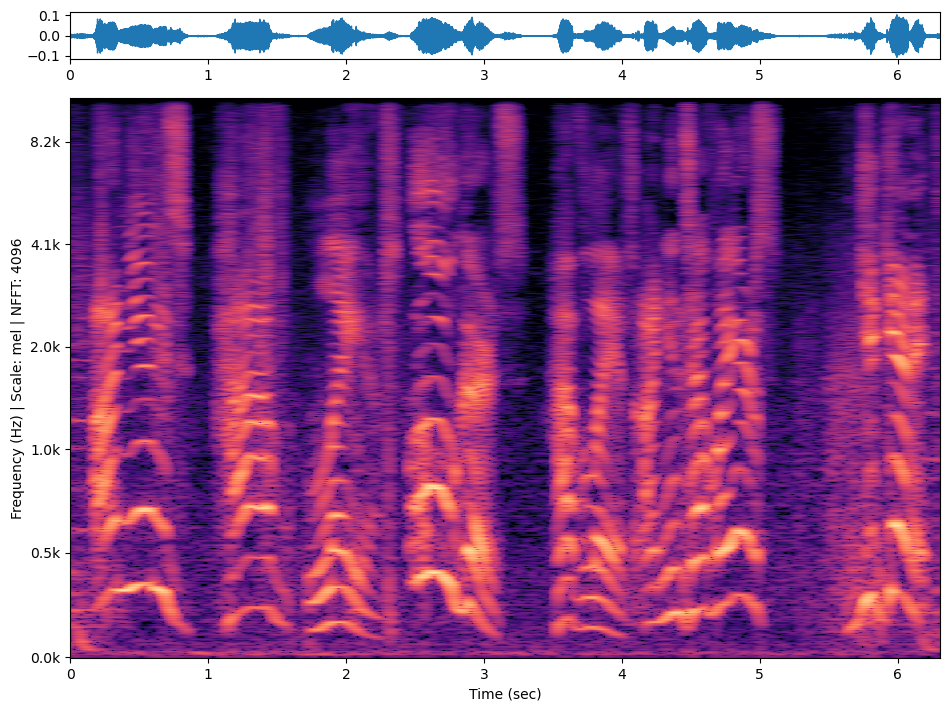

drawing spectrogram with params: {'n_fft': 8192, 'hop_length': 128, 'n_mels': 2048}


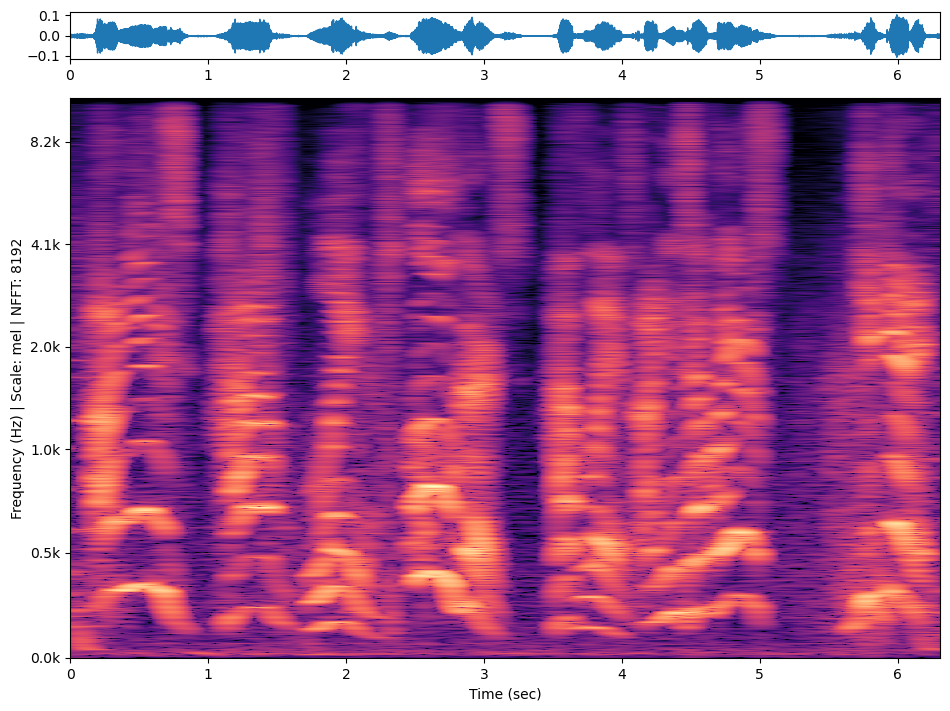

Media/layers.mel.*.png
['Media/layers.mel.00256.png', 'Media/layers.mel.00512.png', 'Media/layers.mel.01024.png', 'Media/layers.mel.02048.png', 'Media/layers.mel.04096.png', 'Media/layers.mel.08192.png']
6


In [53]:
filename = "Media/layers"  # .wav
scale = "mel"  # "linear" #
save = 0

for i in range(8, 14):
    sp = {"n_fft": 2**i, "hop_length": 2 ** (p - 4), "n_mels": 2 ** (i - 2)}
    fig = wav2mp4(filename + ".wav", scale=scale, save=save, spec_params=sp)

make_gif(f"{filename}.{scale}.*.png")

### layers - variable scale

```
layers.2048.*.gif
```
Demonstrates how frequency stretches with scale

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


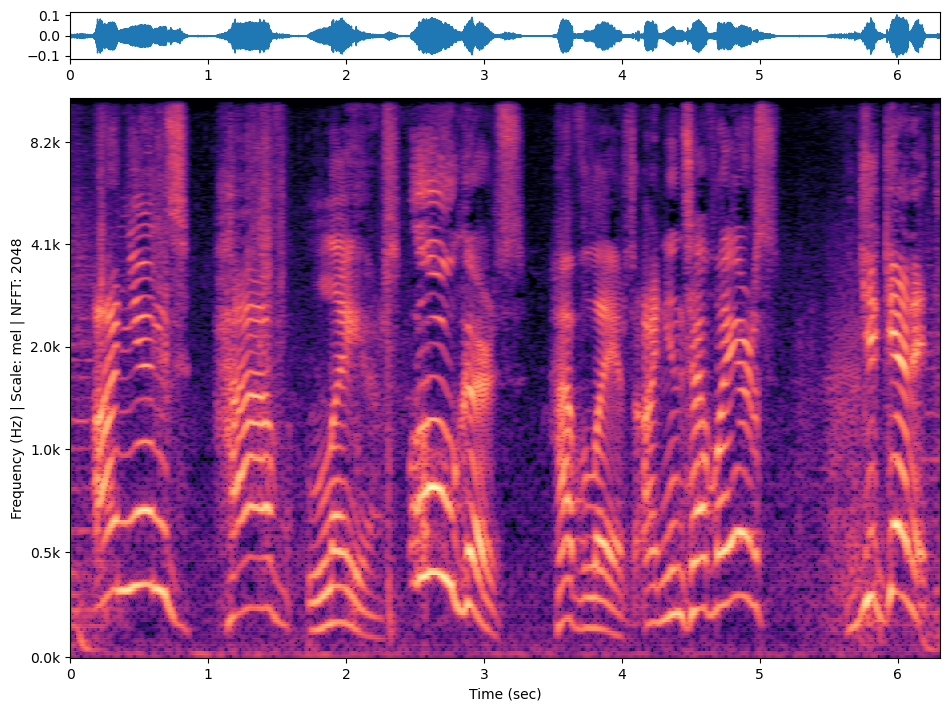

drawing spectrogram with params: {'n_fft': 2048, 'hop_length': 128, 'n_mels': 512}


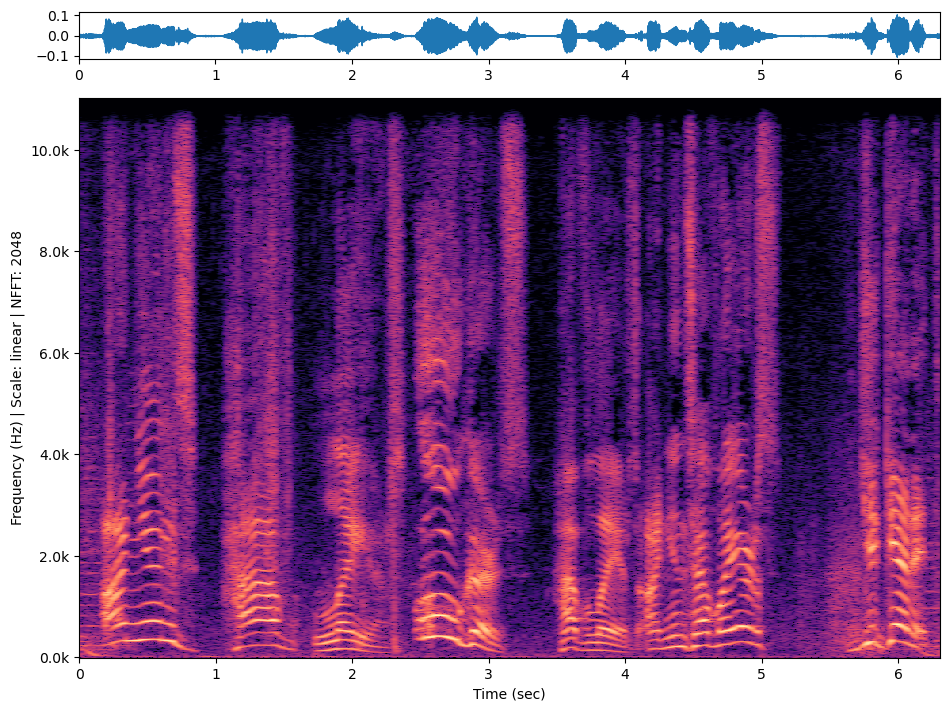

Media/layers.*.02048.png
['Media/layers.linear.02048.png', 'Media/layers.mel.02048.png']
2


In [52]:
filename = "Media/layers"  # .wav
scale = "mel"  # "linear" #
i = 11
save = 0

for j in ["mel", "linear"]:

    sp = {"n_fft": 2**i, "hop_length": 128, "n_mels": 2 ** (i - 2)}
    fig = wav2mp4(filename + ".wav", scale=j, save=save, spec_params=sp)

make_gif(f"{filename}.*.0{2**i}.png")